## 8 - Binary Feature Selection

##### Imports

In [1]:
# Import
import os
import ast
import json
import pandas as pd
import numpy as np
import scipy as su
from collections import defaultdict
# from typing import Dict
# from scipy.signal import
# from scikit-learn import

from matplotlib.path import Path
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns

import dask.dataframe as dd

import pingouin as pg
import statsmodels.api as sm
from statsmodels.stats.anova import AnovaRM
import scipy.stats as stats
import pingouin as pg
from scipy.stats import ttest_rel
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from scipy.stats import boxcox
from scipy.stats import friedmanchisquare
from scipy.stats import levene
from sklearn.ensemble import RandomForestClassifier
from boruta import BorutaPy

##### Data Loading (AoI)

In [52]:
# Load AoI ddfs into dictionary
root_dir = './aoi_data'
def load_aoi_data(root_dir): # Get csv file reads into one dictionary
    data = {}
    for file in os.listdir(root_dir):
        file_path = os.path.join(root_dir, file)
        file_name = os.path.splitext(file)[0]  # file name without '.csv'
        data[file_name] = dd.read_csv(file_path)  # read and attach to dict
    return data

data = load_aoi_data(root_dir)
participant_ids = [1,2,4,5,6,7,8,9,10,12,13,14,15,16,17,18,19,20]

In [53]:
# AoI features (task based)
def convert_to_list(value):
    value = value.replace('nan', 'null')
    result = json.loads(value)
    result = [np.nan if x is None else x for x in result]
    return result

df = pd.read_csv('aoi_data/aoi_features.csv', converters={
    'duration': convert_to_list,
    'fix_count': convert_to_list,
    'fix_freq': convert_to_list,
    'time_1st_fix': convert_to_list,
    'visit_count': convert_to_list,
    'visit_freq': convert_to_list,
    'visit_len': convert_to_list,
    'dwell_pct': convert_to_list,
    'stat_entropy': convert_to_list,
    'trans_entropy': convert_to_list,
})

df['condition'] =  df['difficulty'] + ' ' + df['frequency']

rel_cols = ['participant_id',
 'condition',
 'area',
 'instance',
 'duration',
 'fix_freq',
 'time_1st_fix',
 'visit_freq',
 'visit_len',
 'dwell_pct',
 'stat_entropy',
 'trans_entropy'
 ]
df = df[rel_cols].reset_index(drop=True)

In [54]:
# Easy Slow vs Hard Fast
df = df.query("condition == 'Easy Slow' or condition == 'Hard Fast'")

### 1. Correlation Matrix

##### Metrics only

In [55]:
# Explode lists (no entropies)
list_columns = [
 'duration',
 'fix_freq',
 'time_1st_fix',
 'visit_freq',
 'visit_len',
 'dwell_pct',
 'stat_entropy',
 'trans_entropy'
]

def explode_row(row, list_columns):
    num_elements = len(row[list_columns[0]])
    expanded_rows = pd.DataFrame({
        col: [row[col]] * num_elements if col not in list_columns else row[col]
        for col in row.index
    })
    return expanded_rows

df_expanded = pd.concat(df.apply(explode_row, list_columns=list_columns, axis=1).values).reset_index(drop=True)

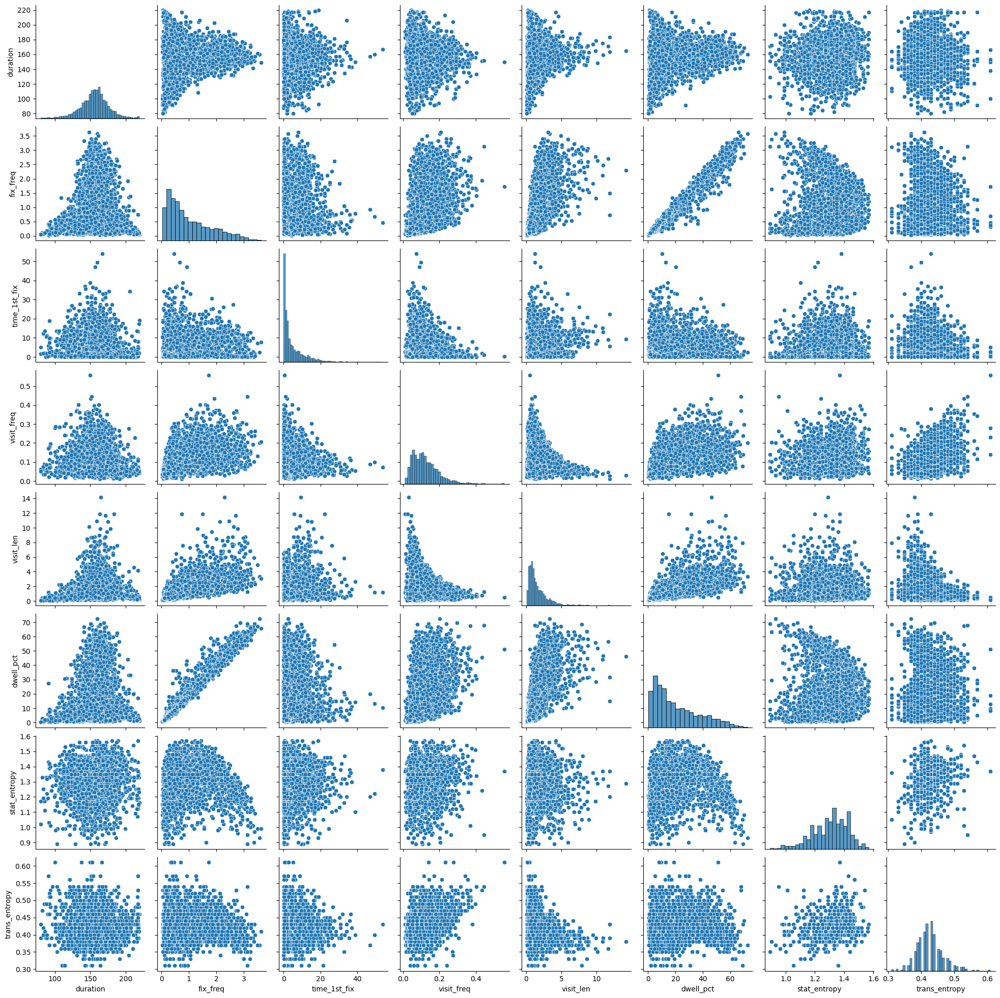

In [56]:
# Visualize pairplot
selected_columns = df_expanded[list_columns]
sns.pairplot(selected_columns)
plt.show()

In [57]:
# Compute correlation
correlation_matrix = df_expanded[list_columns].corr()
correlation_matrix

,duration,fix_freq,time_1st_fix,visit_freq,visit_len,dwell_pct,stat_entropy,trans_entropy
duration,1.000000,0.091916,-0.035859,-0.045843,0.152466,0.123138,0.039792,-0.062993
fix_freq,0.091916,1.000000,-0.017118,0.453526,0.646696,0.979534,-0.038544,-0.056772
time_1st_fix,-0.035859,-0.017118,1.000000,-0.207748,0.167665,-0.020848,-0.045015,-0.100921
visit_freq,-0.045843,0.453526,-0.207748,1.000000,-0.188962,0.474555,0.143094,0.429232
visit_len,0.152466,0.646696,0.167665,-0.188962,1.000000,0.640381,-0.065682,-0.318210
dwell_pct,0.123138,0.979534,-0.020848,0.474555,0.640381,1.000000,-0.026917,0.000738
stat_entropy,0.039792,-0.038544,-0.045015,0.143094,-0.065682,-0.026917,1.000000,0.217663
trans_entropy,-0.062993,-0.056772,-0.100921,0.429232,-0.318210,0.000738,0.217663,1.000000


##### Metrics and Areas

In [58]:
# Pivot df
list_columns = [
 'duration',
 'fix_freq',
 'time_1st_fix',
 'visit_freq',
 'visit_len',
 'dwell_pct',
]
df_pivot = df.pivot_table(index=['participant_id', 'condition', 'instance'],
                          columns='area',
                          values=list_columns,
                          aggfunc='first').reset_index()
df_pivot.columns = [col[0] if col[1] == '' else f"{col[0]}_{col[1]}" for col in df_pivot.columns]

col_order = [
    'participant_id',
    'condition',
    'instance',
    'duration_Ticket',
    'duration_Description',
    'duration_Map',
    'duration_Diagnostics',
    'duration_Actions',
    'fix_freq_Ticket',
    'fix_freq_Description',
    'fix_freq_Map',
    'fix_freq_Diagnostics',
    'fix_freq_Actions',
    'time_1st_fix_Ticket',
    'time_1st_fix_Description',
    'time_1st_fix_Map',
    'time_1st_fix_Diagnostics',
    'time_1st_fix_Actions',
    'visit_freq_Ticket',
    'visit_freq_Description',
    'visit_freq_Map',
    'visit_freq_Diagnostics',
    'visit_freq_Actions',
    'visit_len_Ticket',
    'visit_len_Description',
    'visit_len_Map',
    'visit_len_Diagnostics',
    'visit_len_Actions',
    'dwell_pct_Ticket',
    'dwell_pct_Description',
    'dwell_pct_Map',
    'dwell_pct_Diagnostics',
    'dwell_pct_Actions',
]
df_pivot = df_pivot[col_order]

entropy_columns = ['participant_id', 'condition', 'instance', 'stat_entropy', 'trans_entropy']
unique_entropy_df = df[entropy_columns].drop_duplicates(subset=['participant_id', 'condition', 'instance'])

df_long = pd.merge(df_pivot, unique_entropy_df, on=['participant_id', 'condition', 'instance'], how='left')

In [59]:
# Explode lists
list_columns = [
    'duration_Ticket',
    'duration_Description',
    'duration_Map',
    'duration_Diagnostics',
    'duration_Actions',
    'fix_freq_Ticket',
    'fix_freq_Description',
    'fix_freq_Map',
    'fix_freq_Diagnostics',
    'fix_freq_Actions',
    'time_1st_fix_Ticket',
    'time_1st_fix_Description',
    'time_1st_fix_Map',
    'time_1st_fix_Diagnostics',
    'time_1st_fix_Actions',
    'visit_freq_Ticket',
    'visit_freq_Description',
    'visit_freq_Map',
    'visit_freq_Diagnostics',
    'visit_freq_Actions',
    'visit_len_Ticket',
    'visit_len_Description',
    'visit_len_Map',
    'visit_len_Diagnostics',
    'visit_len_Actions',
    'dwell_pct_Ticket',
    'dwell_pct_Description',
    'dwell_pct_Map',
    'dwell_pct_Diagnostics',
    'dwell_pct_Actions',
    'stat_entropy',
    'trans_entropy'
]

df_long_expanded = pd.concat(df_long.apply(explode_row, list_columns=list_columns, axis=1).values).reset_index(drop=True)

In [60]:
# Visualize pairplot
sns.pairplot(df_long_expanded[list_columns])
plt.show()

In [61]:
# Compute and visualize matrix
correlation_matrix = df_long_expanded[list_columns].corr()

# rename small cols and row
columns_and_rows = correlation_matrix.columns
renamed_columns_rows = [col.split('_')[-1].lower() if '_' in col else col for col in columns_and_rows[:-2]]
renamed_columns_rows.append('stationary')
renamed_columns_rows.append('transition')
correlation_matrix.columns = renamed_columns_rows
correlation_matrix.index = renamed_columns_rows

# create and name big cols and rows
feature_groups = ['fixation duration', 'fixation frequency', 'time to 1st fixation', 'visit_freq', 'visit length', 'dwell time', 'entropy']
group_labels = []
for group in feature_groups[:-1]: 
    group_labels.extend([group] * 5)
group_labels.extend(['entropy'] * 2)

correlation_matrix.columns = pd.MultiIndex.from_tuples(list(zip(group_labels, renamed_columns_rows)))
correlation_matrix.index = pd.MultiIndex.from_tuples(list(zip(group_labels, renamed_columns_rows)))

correlation_matrix

fixation duration                        \
                                            ticket description       map   
fixation duration    ticket               1.000000    0.169740  0.169137   
                     description          0.169740    1.000000  0.190645   
                     map                  0.169137    0.190645  1.000000   
                     diagnostics          0.165990    0.246990  0.142544   
                     actions              0.075222    0.146944  0.059262   
fixation frequency   ticket               0.147248    0.007667  0.002225   
                     description         -0.062284    0.069370 -0.069379   
                     map                 -0.042306   -0.040526  0.317574   
                     diagnostics         -0.032337   -0.052661 -0.210687   
                     actions             -0.034725   -0.110391 -0.063915   
time to 1st fixation ticket              -0.053444    0.009345  0.124940   
                     description          0.017384    0.018850  0.142742   
                     map                  0.077967   -0.053757 -0.163039   
                     diagnostics         -0.012129   -0.016541  0.057341   
                     actions             -0.052250    0.032482  0.093909   
visit_freq           ticket               0.010792   -0.015897 -0.003935   
                     description          0.019210   -0.004893  0.009588   
                     map                  0.022240    0.025199  0.119914   
                     diagnostics         -0.028704   -0.000752 -0.139726   
                     actions              0.007257   -0.017809 -0.153881   
visit length         ticket               0.268257    0.010872 -0.021721   
                     description         -0.006435    0.135759 -0.081580   
                     map                 -0.024835   -0.071046  0.260331   
                     diagnostics          0.034494    0.001954  0.022250   
                     actions             -0.003485   -0.063410  0.113347   
dwell time           ticket               0.270925    0.002785  0.007194   
                     description         -0.050879    0.157650 -0.058338   
                     map                 -0.025545   -0.044012  0.373015   
                     diagnostics         -0.026176   -0.045260 -0.203566   
                     actions             -0.015563   -0.106205 -0.053376   
entropy              stationary           0.089913    0.012796  0.043800   
                     transition           0.014382    0.020868  0.014719   

                                                       fixation frequency  \
                                 diagnostics   actions             ticket   
fixation duration    ticket         0.165990  0.075222           0.147248   
                     description    0.246990  0.146944           0.007667   
                     map            0.142544  0.059262           0.002225   
                     diagnostics    1.000000  0.360749           0.010103   
                     actions        0.360749  1.000000           0.069974   
fixation frequency   ticket         0.010103  0.069974           1.000000   
                     description   -0.127469 -0.080459          -0.025353   
                     map            0.030298  0.036792          -0.051064   
                     diagnostics    0.270205  0.164292          -0.143269   
                     actions        0.056501  0.073536          -0.120499   
time to 1st fixation ticket         0.075954  0.054381          -0.169298   
                     description    0.048129  0.031019           0.061310   
                     map            0.008349  0.030286           0.109975   
                     diagnostics   -0.007003 -0.028471          -0.026909   
                     actions        0.040321  0.046290          -0.101012   
visit_freq           ticket        -0.078097 -0.164090           0.446614   
                     description   -0.180980 -0.160208        

In [62]:
# Get significant correlations
threshold_mask = (correlation_matrix > 0.6) | (correlation_matrix < -0.6)
significant_correlations = correlation_matrix.copy()[threshold_mask].stack(future_stack=True)
significant_correlations = significant_correlations.replace(1.0, np.nan).dropna(axis=0, how='all', subset = feature_groups).fillna('-')
significant_correlations

fixation duration  \
fixation frequency ticket      ticket                      -   
                   description description                 -   
                   map         map                         -   
                   diagnostics diagnostics                 -   
                   actions     actions                     -   
visit_freq         description transition                  -   
                   diagnostics diagnostics                 -   
visit length       ticket      ticket                      -   
                   diagnostics diagnostics                 -   
                               transition                  -   
dwell time         ticket      ticket                      -   
                   description description                 -   
                               diagnostics                 -   
                   map         map                         -   
                   diagnostics description                 -   
                               diagnostics                 -   
                   actions     actions                     -   
entropy            transition  description                 -   
                               diagnostics                 -   

                                           fixation frequency  \
fixation frequency ticket      ticket                       -   
                   description description                  -   
                   map         map                          -   
                   diagnostics diagnostics                  -   
                   actions     actions                      -   
visit_freq         description transition                   -   
                   diagnostics diagnostics                  -   
visit length       ticket      ticket                       -   
                   diagnostics diagnostics                  -   
                               transition                   -   
dwell time         ticket      ticket                0.954172   
                   description description           0.960939   
                               diagnostics                  -   
                   map         map                   0.974535   
                   diagnostics description                  -   
                               diagnostics           0.943132   
                   actions     actions               0.924684   
entropy            transition  description                  -   
                               diagnostics                  -   

                                           time to 1st fixation visit_freq  \
fixation frequency ticket      ticket                         -          -   
                   description description                    -          -   
                   map         map                            -          -   
                   diagnostics diagnostics                    -          -   
                   actions     actions                        -          -   
visit_freq         description transition                     -          -   
                   diagnostics diagnostics                    -          -   
visit length       ticket      ticket                         -          -   
                   diagnostics diagnostics                    -  -0.608913   
                               transition                     -          -   
dwell time         ticket      ticket                         -          -   
                   description description                    -          -   
                               diagnostics                    -          -   
                   map         map                            -          -   
                   diagnostics description                    -          -   
                               diagnostics                    -          -   
                   actions     actions                        -          -   
entropy            transition  description               

##### Remove correlated features

To remove:
- dwell_pct (all areas)
- trans_entropy
- visit_freq (diagnostic)

In [63]:
# Remove columns
columns_to_remove = [
    'visit_freq_Diagnostics',

    'dwell_pct_Ticket',
    'dwell_pct_Description',
    'dwell_pct_Map',
    'dwell_pct_Diagnostics',
    'dwell_pct_Actions',

    'trans_entropy',
]
df_long_expanded = df_long_expanded.drop(columns=columns_to_remove)

### 2. Random Forest

##### Random Forest Classifier

In [64]:
# Prepare variables
X = df_long_expanded.drop(columns=['participant_id', 'instance', 'condition'])
y = df_long_expanded['condition'].apply(lambda x: 0 if x == "Easy Slow" else 1)

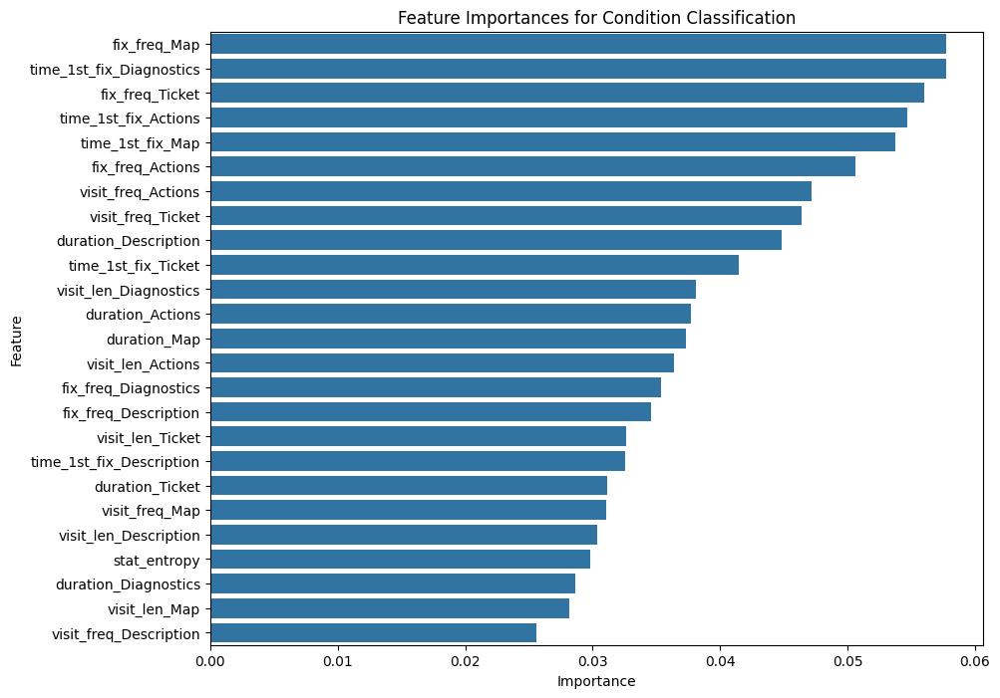

In [65]:
# Fit model and plot Feature Importances
feature_importance_tracker = pd.DataFrame(0, index=X.columns, columns=range(1, 101))
for random_state in range(1, 101):
    rf = RandomForestClassifier(criterion='entropy', n_estimators=100, random_state=random_state, class_weight='balanced')
    rf.fit(X, y)
    feature_importance_tracker[random_state] = rf.feature_importances_

feature_importances_avg_df = feature_importance_tracker.mean(axis=1).sort_values(ascending=False).reset_index()
feature_importances_avg_df.columns = ['feature', 'importance_avg']

# Plotting the average feature importance
plt.figure(figsize=(10, 8))
sns.barplot(x='importance_avg', y='feature', data=feature_importances_avg_df)
plt.title('Feature Importances for Condition Classification')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

##### Boruta Feature Selection

In [66]:
# Prepare variables
X_cleaned = X.dropna()
y = df_long_expanded.dropna()['condition'].apply(lambda x: 0 if x == "Easy Slow" else 1)

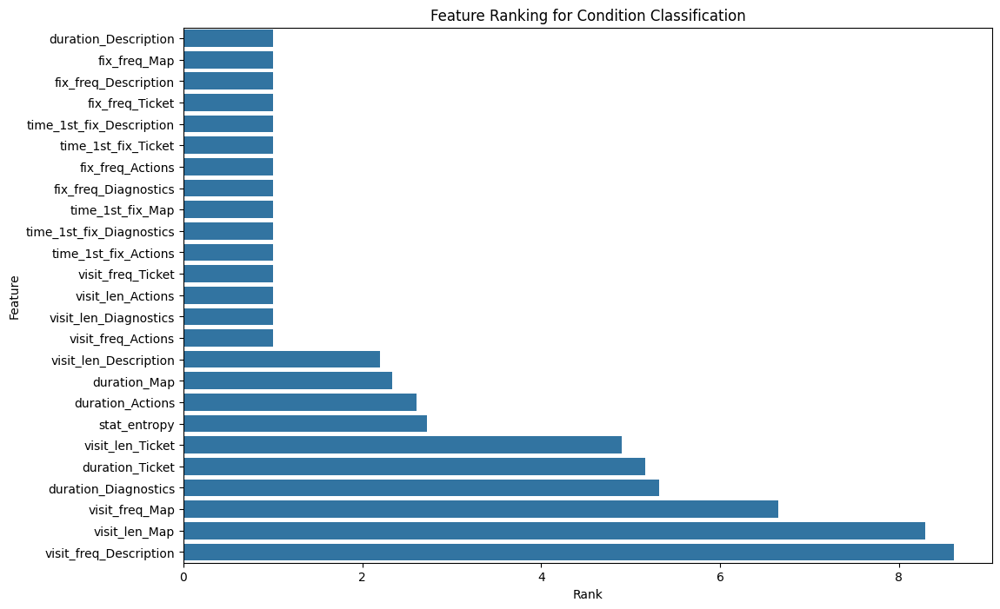

In [67]:
# Run Boruta Selection (max_depth=7)
ranking_dict = defaultdict(list)
for random_state in range(1, 101):
    rf = RandomForestClassifier(criterion='entropy', max_depth=7, random_state=random_state, class_weight='balanced', n_jobs=-1, )
    feat_selector = BorutaPy(rf, n_estimators='auto', random_state=random_state)
    
    feat_selector.fit(X_cleaned.values, y)
    for feature, rank in zip(X_cleaned.columns, feat_selector.ranking_):
        ranking_dict[feature].append(rank)

# Plot ranking
average_ranking = {feature: np.mean(ranks) for feature, ranks in ranking_dict.items()}
feature_ranking_df = pd.DataFrame({
    'feature': list(average_ranking.keys()),
    'rank_avg': list(average_ranking.values())
}).sort_values(by='rank_avg')

plt.figure(figsize=(12, 8))
sns.barplot(x='rank_avg', y='feature', data=feature_ranking_df)
plt.title("Feature Ranking for Condition Classification")
plt.xlabel("Rank")
plt.ylabel("Feature")
plt.show()

--> Why do we have so many features ranking first?  
Because they consistently receive higher feature importances than the max shadow feature.

##### Select Best-Ranking Features

In [68]:
# Select columns
best_features = [
    'duration_Description',     # more important

    'fix_freq_Ticket',
    'fix_freq_Description',
    'fix_freq_Map',
    'fix_freq_Diagnostics',
    'fix_freq_Actions',

    'time_1st_fix_Ticket',
    'time_1st_fix_Description',
    'time_1st_fix_Map',
    'time_1st_fix_Diagnostics',
    'time_1st_fix_Actions',

    'visit_freq_Ticket',
    'visit_freq_Actions',

    'visit_len_Diagnostics',
    'visit_len_Actions',
]
df_long_expanded = df_long_expanded[['participant_id', 'condition'] + best_features]

### 3. Export Data

In [69]:
# Export
df_long_expanded.to_csv('./aoi_data/RQ3_features_bin.csv', index=False)